In [1]:
%run -n boillerplate.ipynb

# Figure 4 : Coefficient maps for the 96 labels decoding (Btheta x Theta)
Note : data shuffling might give different indices to the same neurons between multiple runs, hence why the coeffmaps won't look like what we show in the article

# Params

In [2]:
tsteps = [20, 30, 40]

# Decoding

In [4]:
try :
    coeffmat = np.load('./data/fig_4_coeffmaps.npy')
    interceptmat = np.load('./data/fig_4_intercept.npy')
except :
    try:
        data = np.load('./data/data_all_t_bt.npy')
        labels = np.load('./data/labels_all_t_bt.npy')
    except:    
        data, labels, le = par_load_temporal_data(timesteps = timesteps, target_btheta = None,
                                                  target_theta = None, data_type = 'all_t_bt',
                                                  cluster_list = cluster_list)
        np.save('./data/data_all_t_bt.npy', data)
        np.save('./data/labels_all_t_bt.npy', labels)

    # Classifying
    logreg = LogisticRegression(**opts_LR)

    intercepts = []
    coeffs = []
    for ibin in tqdm(range(data.shape[0]), desc='Decoding') :
        xtrain, xtest, ytrain, ytest = train_test_split(data[ibin,:,:], labels, test_size=test_size, random_state = 42)
        logreg.fit(xtrain, ytrain)
        coeffs.append(logreg.coef_)
        intercepts.append(logreg.intercept_)

    coeffmat = np.asarray(coeffs)
    interceptmat = np.asarray(intercepts)
    
    np.save('./data/fig_4_coeffmaps.npy', coeffmat)
    np.save('./data/fig_4_intercept.npy', interceptmat)

Decoding: 100%|██████████| 61/61 [11:51<00:00, 11.67s/it]


# Showing intercept maps

In [5]:
interceptmat.shape, interceptmat.min(), interceptmat.mean(), interceptmat.max()

((61, 96), -10.075397268817515, -1.1286660737773996e-14, 8.865327105752698)

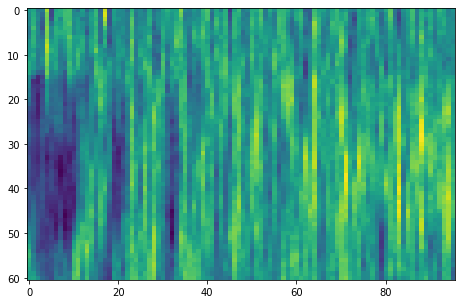

In [6]:
fig, ax = plt.subplots(figsize = (12,5))
ax.imshow(interceptmat)


In [7]:
n_cols = 5
ibins = interceptmat.shape[0]
ibins

61

In [8]:
print(range(0, ibins, ibins//n_cols), np.linspace(0, 61, n_cols+1))

range(0, 61, 12) [ 0.  12.2 24.4 36.6 48.8 61. ]


In [9]:
ibins//n_cols, [int(i) for i in range(0, ibins, ibins//n_cols)], [(i_col*ibins)//n_cols for i_col in range(n_cols)]

(12, [0, 12, 24, 36, 48, 60], [0, 12, 24, 36, 48])

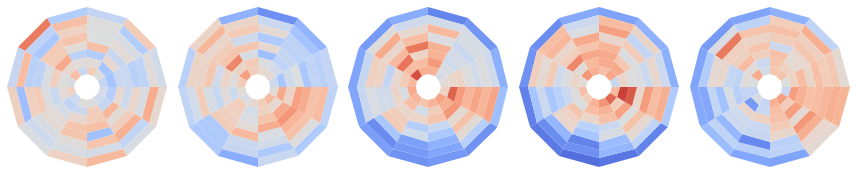

In [10]:
if True:
    n_cols = 5
    ibins = interceptmat.shape[0]
    
    fig, axs = plt.subplots(ncols = n_cols, figsize = (12, 3), subplot_kw=dict(projection="polar", aspect = 'equal'))
    for i_col in range(n_cols) :         
        start = (i_col*ibins)//n_cols
        stop = start + ibins//n_cols
        intercepts = interceptmat[start:stop, :].mean(axis=0).reshape((N_B_thetas, N_thetas))

        ax = axs[i_col]
        pc = ax.pcolormesh(AZ*2, EL, intercepts.T,
                           cmap="coolwarm", edgecolors = 'none', linewidth = 0.,
                           antialiased = True, norm = mcols.TwoSlopeNorm(
                           vmin = np.min(interceptmat),
                           vmax = np.max(interceptmat), vcenter = 0))

        ax.spines['polar'].set_visible(False)
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticklabels([])

    fig.tight_layout()
    plt.show()


# Showing coef maps

In [11]:
np.geomspace(.01, 3, 10)

array([0.01      , 0.01884672, 0.03551987, 0.0669433 , 0.12616613,
       0.23778173, 0.44814047, 0.84459764, 1.59178922, 3.        ])

In [12]:
coeffmat = np.swapaxes(coeffmat, 0, 1)
coeffmat.shape

(96, 61, 256)

In [13]:
if False :
    i = 0
    ncols = 5
    while i < coeffmat.shape[-1] :
        fig, ax = plt.subplots(ncols = ncols, figsize = (15, 5))
        for i2 in range(ncols) :
            try :
                ax[i2].matshow(coeffmat[:,:,i+i2])
                ax[i2].axvline(10, linestyle = '--', color = 'k', alpha = .7)

                ax[i2].axis('off')
                ax[i2].text(.95, 5, i+i2, c = 'r')
            except IndexError :
                pass
        fig.tight_layout()
        plt.show()
        i+=ncols

In [14]:

rbins, abins = np.linspace(0.1, B_thetas[0], N_B_thetas+1), np.linspace(0, np.pi, N_thetas+1)
EL, AZ = np.meshgrid(rbins, abins)


In [15]:
AZ.max()

3.141592653589793

In [16]:
coeffmat.shape

(96, 61, 256)

In [17]:
idx = 48
coeffmat[:, 20:40, idx].shape

(96, 20)

In [18]:
coeffmat[:, 20:40, idx].mean(axis=-1).shape

(96,)

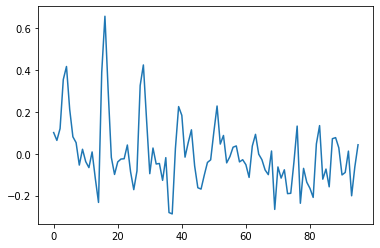

In [19]:
coeffs = coeffmat[:, 20:40, idx].mean(axis=-1)
plt.plot(coeffs)

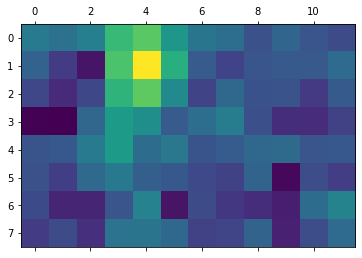

In [20]:
plt.matshow(coeffs.reshape((N_B_thetas, N_thetas)))

In [21]:
if False :
    fig, ax = plt.subplots(figsize = (12,5), subplot_kw=dict(projection="polar", aspect = 'equal'))
    ax.pcolormesh(AZ, EL, coeffs.reshape((N_B_thetas, N_thetas)).T,
                       cmap="coolwarm", edgecolors = 'k', linewidth = .75,
                       antialiased = True, norm = mcols.TwoSlopeNorm(
                       vmin = np.min(coeffs),
                       vmax = np.max(coeffs), vcenter = 0))

In [22]:
if False :
    i = 0
    n_cols = 5
    for i_line in range(coeffmat.shape[-1]//n_cols):
        fig, axs = plt.subplots(ncols = n_cols, figsize = (12, 3), subplot_kw=dict(projection="polar", aspect = 'equal'))
        for i_col in range(ncols) :         
            i = i_line * n_cols + i_col
            coeffs = coeffmat[:, 20:40, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))

            ax = axs[i_col]
            pc = ax.pcolormesh(AZ, EL, coeffs.T,
                               cmap="coolwarm", edgecolors = 'k', linewidth = .75,
                               antialiased = True, norm = mcols.TwoSlopeNorm(
                               vmin = np.min(coeffs),
                               vmax = np.max(coeffs), vcenter = 0))
            ax.set_thetamin(0)
            ax.set_thetamax(180)
            ax.set_ylim(-.05, AZ.max()+.005)

            ax.spines['polar'].set_visible(False)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.text(3*np.pi/4, EL.max()*1.2, i, c = 'r')
                
        fig.tight_layout()
        plt.show()


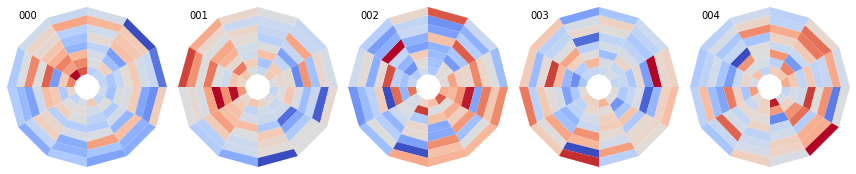

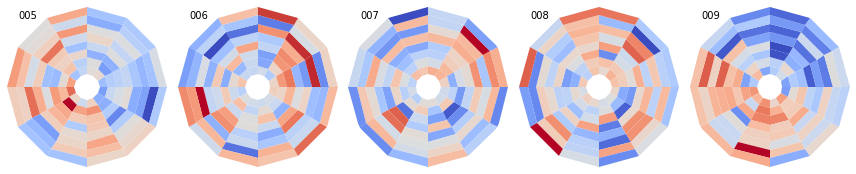

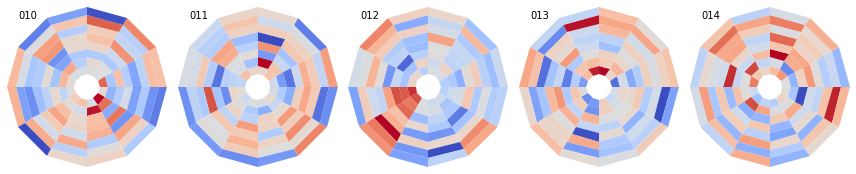

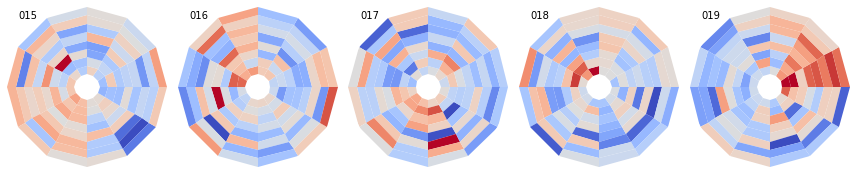

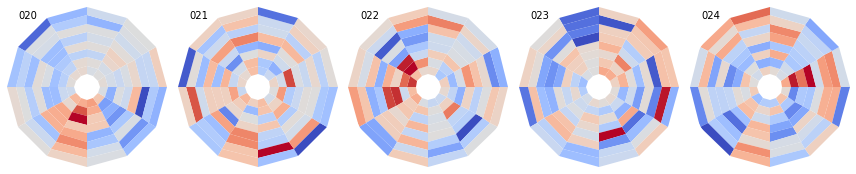

...

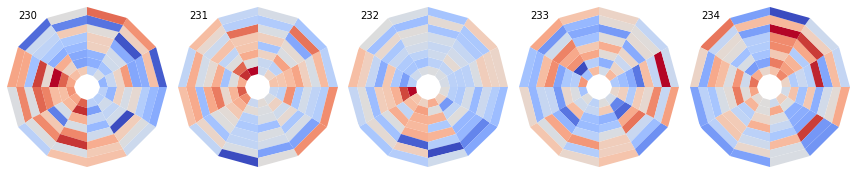

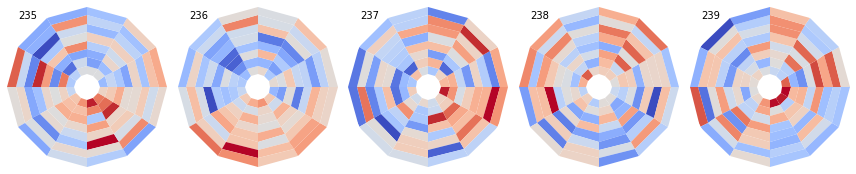

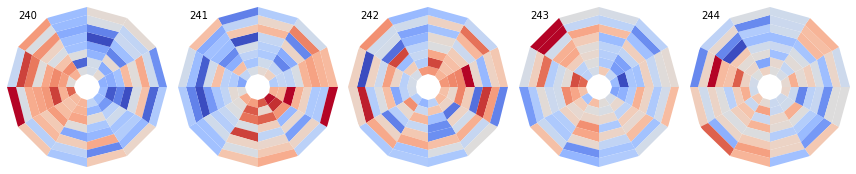

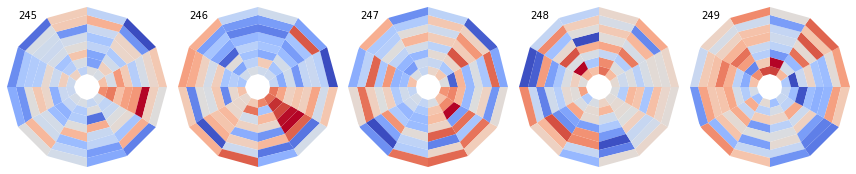

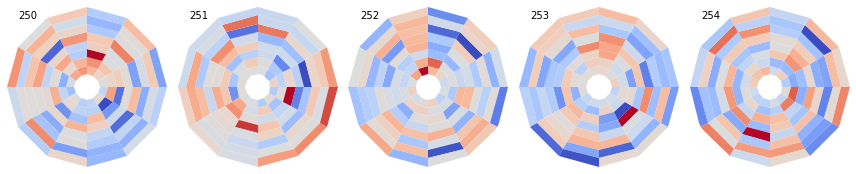

In [23]:
if True:
    n_cols = 5
    for i_line in range(coeffmat.shape[-1]//n_cols):
        fig, axs = plt.subplots(ncols = n_cols, figsize = (12, 3), subplot_kw=dict(projection="polar", aspect = 'equal'))
        for i_col in range(n_cols) :         
            i = i_line * n_cols + i_col
            coeffs = coeffmat[:, 20:40, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))

            ax = axs[i_col]
            pc = ax.pcolormesh(AZ*2, EL, coeffs.T,
                               cmap="coolwarm", edgecolors = 'none', linewidth = 0.,
                               antialiased = True, norm = mcols.TwoSlopeNorm(
                               vmin = np.min(coeffs),
                               vmax = np.max(coeffs), vcenter = 0))
            #ax.set_thetamin(0)
            #ax.set_thetamax(180)
            #ax.set_ylim(-.05, AZ.max()+.005)

            ax.spines['polar'].set_visible(False)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticklabels([])
            ax.text(3*np.pi/4, EL.max()*1.21, f'{i:03d}', c = 'k')
                
        fig.tight_layout()
        plt.show()


In [24]:
if False :
    n_cols = 5
    for i_line in range(coeffmat.shape[-1]//n_cols):
        for diff in [False, True]:
            fig, axs = plt.subplots(ncols = n_cols, figsize = (12, 3), subplot_kw=dict(projection="polar", aspect = 'equal'))
            for i_col in range(n_cols) :         
                i = i_line * n_cols + i_col
                if diff:
                    coeffs = coeffmat[:, 15:30, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                    coeffs -= coeffmat[:, 30:45, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                else:
                    coeffs = coeffmat[:, 15:45, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                    
                ax = axs[i_col]
                pc = ax.pcolormesh(AZ*2, EL, coeffs.T,
                                   cmap="Spectral" if diff else "coolwarm", edgecolors = 'none', linewidth = 0.,
                                   antialiased = True, norm = mcols.TwoSlopeNorm(
                                   vmin = np.min(coeffs),
                                   vmax = np.max(coeffs), vcenter = 0))

                ax.spines['polar'].set_visible(False)
                ax.grid(False)
                ax.set_xticks([])
                ax.set_yticklabels([])
                ax.text(3*np.pi/4, EL.max()*1.21, f'{i:03d}', c = 'k')

            fig.tight_layout()
            plt.show()


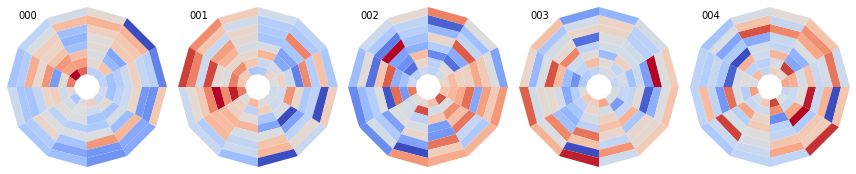

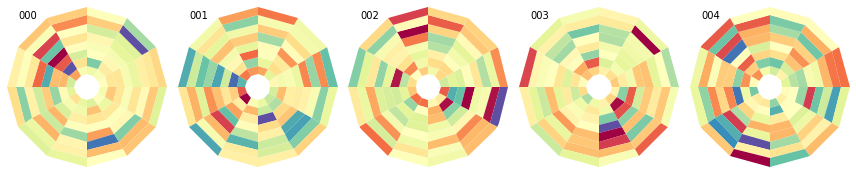

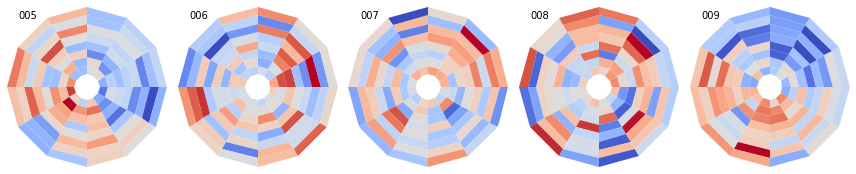

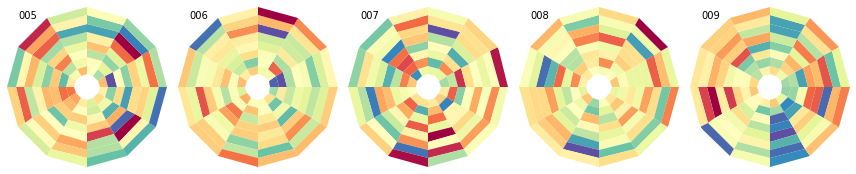

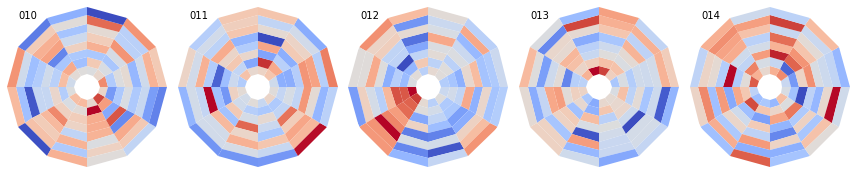

...

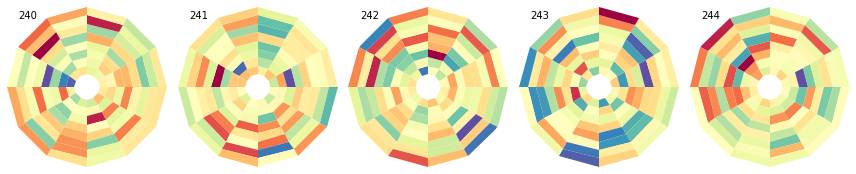

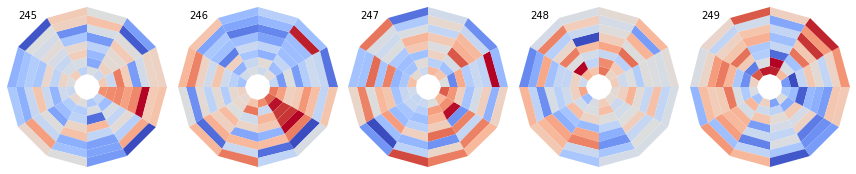

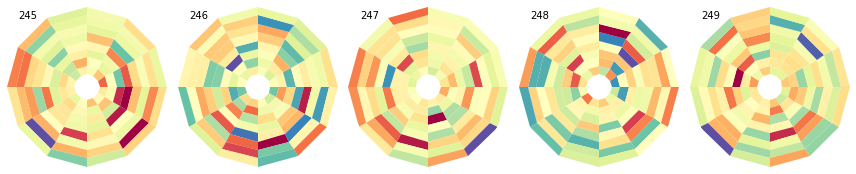

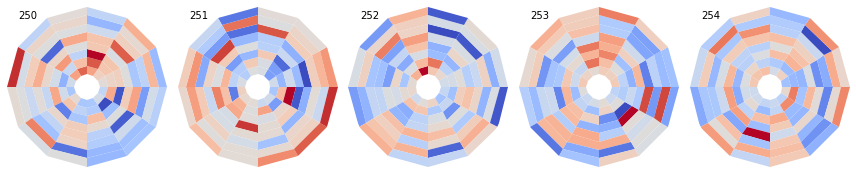

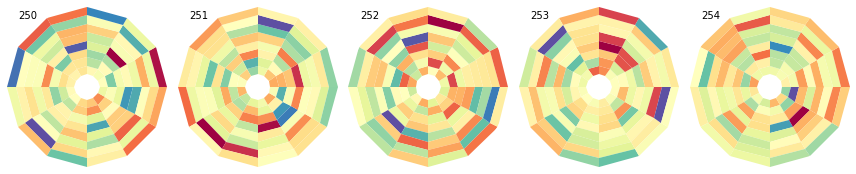

In [25]:
if True :
    n_cols = 5
    for i_line in range(coeffmat.shape[-1]//n_cols):
        for diff in [False, True]:
            fig, axs = plt.subplots(ncols = n_cols, figsize = (12, 3), subplot_kw=dict(projection="polar", aspect = 'equal'))
            for i_col in range(n_cols) :         
                i = i_line * n_cols + i_col
                if diff:
                    coeffs = coeffmat[:, 15:30, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                    coeffs -= coeffmat[:, 30:45, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                else:
                    coeffs = coeffmat[:, 15:45, i].mean(axis=-1).reshape((N_B_thetas, N_thetas))
                    
                ax = axs[i_col]
                pc = ax.pcolormesh(AZ*2, EL, coeffs.T,
                                   cmap="Spectral" if diff else "coolwarm", edgecolors = 'none', linewidth = 0.,
                                   antialiased = True, norm = mcols.TwoSlopeNorm(
                                   vmin = np.min(coeffs),
                                   vmax = np.max(coeffs), vcenter = 0))

                ax.spines['polar'].set_visible(False)
                ax.grid(False)
                ax.set_xticks([])
                ax.set_yticklabels([])
                ax.text(3*np.pi/4, EL.max()*1.21, f'{i:03d}', c = 'k')

            fig.tight_layout()
            plt.show()


# Some selected examples

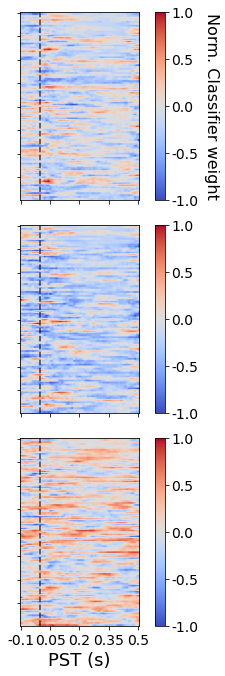

In [26]:
size = 5

idxs = [54, 238, 2]
fig, axs = plt.subplots(figsize = (5,9.5), nrows = len(idxs))

t_idxs = np.array([0, 15, 30, 45, 60])
t_idxs_labels = np.array([-.1, 0., 0.1, 0.2, 0.3])
t_idxs_labels = np.round(timesteps[t_idxs] + win_size,2)

for i, ax in enumerate(axs) :
    a = norm_minus(coeffmat[:,:,idxs[i]])
    ims = axs[i].imshow(a, cmap = 'coolwarm',
                        norm = mcols.TwoSlopeNorm(
                        vmin = np.min(a),
                        vmax = np.max(a), vcenter = 0))
    
    axs[i].set_xticks(t_idxs)
    
    axs[i].axvline(10, linestyle = '--', color = 'k', alpha = .7)
    if i == 2 :
        axs[i].set_xticklabels(t_idxs_labels)
         
        axs[i].set_yticks(np.arange(0,96, 12))
        axs[i].set_yticklabels([])
        axs[i].set_xlabel('PST (s)', fontsize = 18)
        
        
    else :
        axs[i].set_yticks(np.arange(0,96, 12))
        axs[i].set_yticklabels([])
        axs[i].set_xticklabels([])
        
        
    cb_ticks = np.linspace(np.min(a),
                          np.max(a),
                          5)
    cb = fig.colorbar(ims, ax = ax, ticks = cb_ticks)
    cb.ax.tick_params(labelsize = 14)
    cb.ax.set_yticklabels(np.round(cb_ticks,2))
    if i == 0 :
        cb.ax.set_ylabel('Norm. Classifier weight', rotation = 270, labelpad = 20, fontsize = 16)

    axs[i].tick_params(axis='both', which='major', labelsize=14)
    
    
fig.tight_layout()
fig.savefig('./output/fig_4_coeffmaps.pdf', bbox_inches='tight', dpi=200, transparent=True)
plt.show()

In [27]:
for sel_cluster in idxs :
    cluster_path = cluster_list[sel_cluster]
    load_folder = '%s/%s' % (grouping_path, cluster_path)
    mean_FR = np.load(load_folder + '/0.000_plot_MC_TC_nonmerged_all.npy')
    
    pref_ori = np.argmax(np.mean(mean_FR[-1,:,:], axis = -1))
    print(thetas[pref_ori]*180/np.pi)
    print(pref_ori)
    print('--')

29.999999999999996
2
--
59.99999999999999
4
--
164.99999999999997
11
--


In [28]:
from scipy.signal import find_peaks

In [29]:
new_mat = np.zeros_like(coeffmat)
for itheta, theta in enumerate(thetas) :
    select_idxs = np.arange(itheta, coeffmat.shape[0], N_thetas)
    insert_idx = (itheta*len(select_idxs)) 
    new_mat[insert_idx : insert_idx+ len(select_idxs), :, :] = coeffmat[select_idxs, :, :]
    
frac_peak = .75  # fraction of the maximum of the array that can be defined as a peak

all_bt_peaks, all_t_peaks = [], []
for neur_idx in range(coeffmat.shape[-1]):
    n_bt_peaks, n_t_peaks = [], []
    for t_idx in range(coeffmat.shape[1]):
        bt_mat = coeffmat[:, t_idx, neur_idx]
        t_mat = new_mat[:, t_idx, neur_idx]
        
        # Find peaks of Btheta (min 0, max 8)
        peaks, props = find_peaks(bt_mat,
                                  height=frac_peak * np.max(bt_mat),
                                  distance=12)
        n_bt_peaks.append(len(peaks))
        
        # Find peaks of Theta (min 0, max 12)
        peaks, props = find_peaks(t_mat,
                                  height=frac_peak * np.max(t_mat),
                                  distance=8)
        n_t_peaks.append(len(peaks))
        
    all_bt_peaks.append(n_bt_peaks)
    all_t_peaks.append(n_t_peaks)
    
all_bt_peaks = np.asarray(all_bt_peaks)
all_t_peaks = np.asarray(all_t_peaks)

In [30]:
all_t_peaks.shape

(256, 61)

In [31]:
np.std(all_bt_peaks)

1.1362597515715855

In [32]:
# Still on the coeffmaps, we can see at each timestep + integration window (ws)
# which btheta is the preferred one, and which theta is the preffered one in those
# i.e argmax btheta and agrmax(theta | btheta)

btt_prefs = []
ws = 10
tinit = 20
for i in idxs :
    a = coeffmat[:,:,i]
    
    # get the pref btheta
    amaxs = []
    for t in range(a.shape[-1]-ws-tinit) :
        amaxs.append(np.argmax(np.mean(a[:,t+tinit:t+tinit+ws], axis = -1)) // N_thetas)
    
    # get the pref theta
    btt = np.zeros((2, len(amaxs)))
    for t in range(len(amaxs)) :
        bt = amaxs[t]
        tt = np.argmax(np.mean(coeffmat[bt*12:(bt+1)*12,t:t+ws,i], axis = 1))
        
        btt[:,t] = (bt, tt)
        
    btt_prefs.append(btt)
    
btt_prefs = np.asarray(btt_prefs)

In [33]:
# now to access the preferred bthetas, you only need to specify timestep - ws
print(btt_prefs.shape)
print('Unique bthetas % s' % np.unique(btt_prefs[0,:,:10], axis = -1)[1]) 
print('Unique thetas %s ' % np.unique(btt_prefs[0,:,:10], axis = -1)[0])

(3, 2, 31)
Unique bthetas [8. 1. 1.]
Unique thetas [2. 4. 6.] 


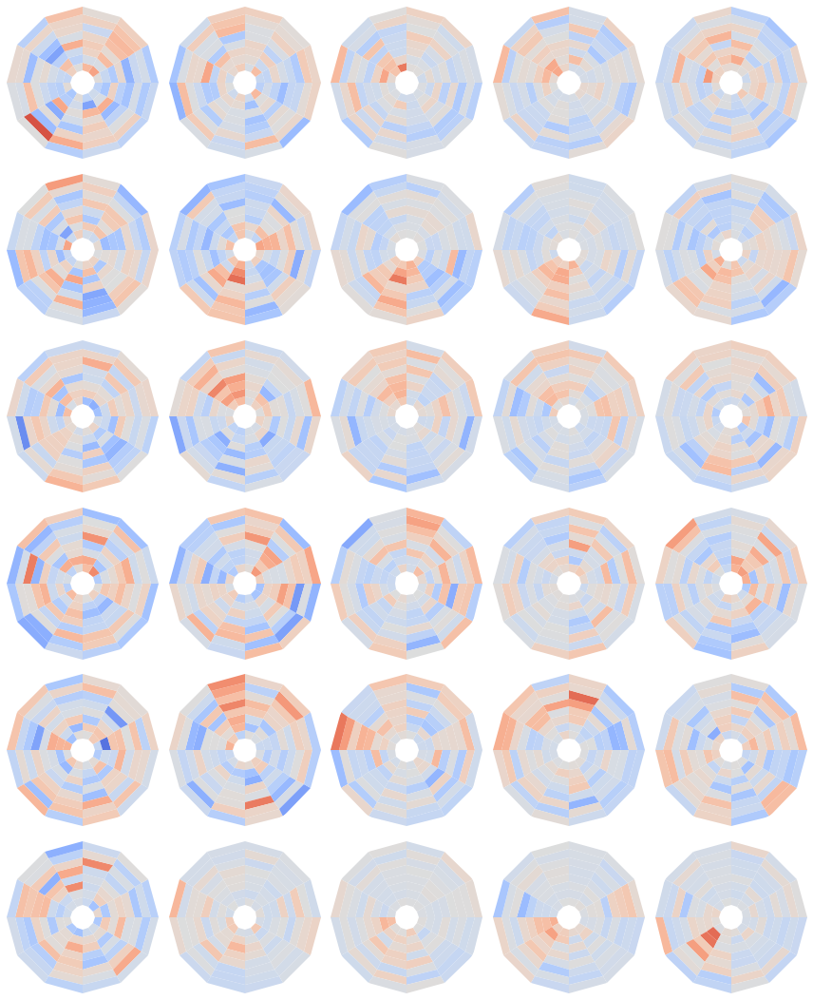

In [34]:

idxs = [18, 20, 25, 214, 226, 232]
if True:
    n_cols = 5
    ibins = interceptmat.shape[0]
    
    fig, axs = plt.subplots(ncols = n_cols, nrows = len(idxs), figsize = (12, 3*len(idxs)), subplot_kw=dict(projection="polar", aspect = 'equal'))

    for i_row, idx in enumerate(idxs) :         
        for i_col in range(n_cols) :         
            start = (i_col*ibins)//n_cols
            stop = start + ibins//n_cols
            coeffs = coeffmat[:, start:stop, idx].mean(axis=1).reshape((N_B_thetas, N_thetas))

            ax = axs[i_row][i_col]
            pc = ax.pcolormesh(AZ*2, EL, coeffs.T,
                               cmap="coolwarm", edgecolors = 'none', linewidth = 0.,
                               antialiased = True, norm = mcols.TwoSlopeNorm(
                               vmin = np.min(coeffmat[:, :, idx]),
                               vmax = np.max(coeffmat[:, :, idx]), vcenter = 0))

            ax.spines['polar'].set_visible(False)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticklabels([])

        fig.tight_layout()
    plt.show()


# Polar plot histogram (emitting fields)

In [35]:
timesteps[5], timesteps[20], timesteps[50]

(-0.14999999999999997, 1.6653345369377348e-16, 0.30000000000000043)

In [36]:
timesteps[[20, 35, 45]]

array([1.66533454e-16, 1.50000000e-01, 2.50000000e-01])

In [37]:
timesteps[10] - timesteps[0]

0.10000000000000009

In [38]:
def make_histo(mat, start_slice, n_slices, N_thetas=N_thetas, N_B_thetas=N_B_thetas) :
    histo = np.zeros((N_thetas, N_B_thetas, n_slices))
    for i in range(n_slices):
        arr = mat[:, start_slice + i]

        for bt in range(N_B_thetas) :
            for t in range(N_thetas) :
                histo[t, -bt, i] = arr[(bt*N_B_thetas) + (t)]
                
    return histo

In [39]:
# Maybe we can do the same with histolists
btt_prefs_histo = []
tsteps_markers = np.arange(0, tsteps[-1])
n_slices = 10
all_btt_prefs = []
for i in idxs :
    mat = coeffmat[:,:,i]
    list_histo = [make_histo(mat = mat, start_slice = x, n_slices = 10) for x in tsteps_markers]
    
    btt_prefs = []
    for i1, histo in enumerate(list_histo) :
        histo = np.mean(histo, axis = -1)
        where_amax = np.where(histo == histo.max())
        
        if len(where_amax[0]) > 1 :
            for i2 in range(len(where_amax[0])) :
                btt_prefs.append(np.array([where_amax[0][i2], where_amax[1][i2]]))
        else :
            btt_prefs.append(np.concatenate(where_amax))
    
    all_btt_prefs.append(btt_prefs)
    
all_btt_prefs = np.asarray(all_btt_prefs)

/usr/local/lib/python3.9/site-packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)


IndexError: index 3 is out of bounds for axis 1 with size 3

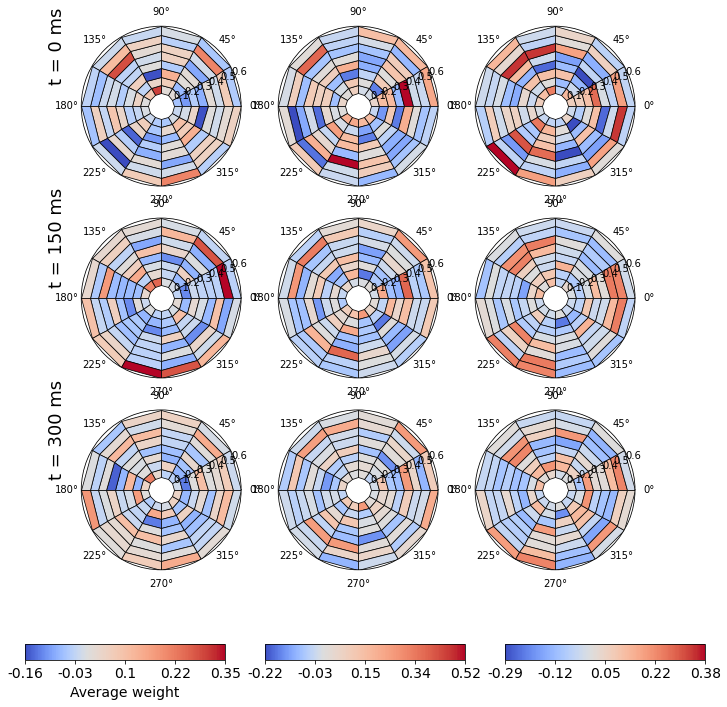

In [40]:
fig, axs = plt.subplots(figsize = (10,10), ncols = 3, nrows = 3,
                       subplot_kw=dict(projection="polar", aspect = 'equal'))

n_slices = 10 #100 ms avg

times = ['t = 0 ms', 't = 150 ms', 't = 300 ms']

for i0, matidx in enumerate(idxs):
    mat = coeffmat[:,:,matidx]
    
    load_folder = '%s/%s' % (grouping_path, cluster_list[matidx])
    mean_FR = np.load(load_folder + '/0.000_plot_MC_TC_nonmerged_all.npy')
    pref_ori = np.argmax(np.mean(mean_FR[-1,:,:], axis = -1))

    list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slices) for x in tsteps]
    #list_histo = norm_data(list_histo)
    for i1, tstep in enumerate(tsteps) :
        histo = list_histo[i1]
        
        ax = axs[i1, i0]
        pc = ax.pcolormesh(AZ*2, EL, np.mean(histo, axis = -1),
                           cmap="coolwarm", edgecolors = 'k', linewidth = .75,
                           antialiased = True, norm = mcols.TwoSlopeNorm(
                           vmin = np.min(np.mean(list_histo, axis = -1)),
                           vmax = np.max(np.mean(list_histo, axis = -1)), vcenter = 0))
        
        # in grey the part that were randomly activated before stim
        '''thetas_marker = np.unique(all_btt_prefs[i0][:19], axis = 0)[:,0]
        bthetas_marker = np.unique(all_btt_prefs[i0][:19], axis = 0)[:,1]
        for imark in range(len(thetas_marker)) :
            #ax.scatter(thetas_marker[imark], bthetas_marker[imark], color = 'r')
            ax.plot([rbins[thetas_marker[imark]], rbins[thetas_marker[imark]+1], rbins[thetas_marker[imark]+1],
                    rbins[thetas_marker[imark]], rbins[thetas_marker[imark]]],
                    
                   [abins[bthetas_marker[imark]], abins[bthetas_marker[imark]], abins[bthetas_marker[imark]+1],
                   abins[bthetas_marker[imark]+1], abins[bthetas_marker[imark]]],
                    
                    c = 'k', linestyle = (0, (2, .5)),
                    linewidth = 2, zorder = 10 if i1 == 0 else 4)
        '''    
        # Color in black the parts that were evoked
        thetas_marker = np.unique(all_btt_prefs[i0][19:tstep+1], axis = 0)[:,0]
        bthetas_marker = np.unique(all_btt_prefs[i0][19:tstep+1], axis = 0)[:,1]
        if False: #for imark in range(len(thetas_marker)) :
            #ax.scatter(thetas_marker[imark], bthetas_marker[imark], color = 'r')
            ax.plot([rbins[thetas_marker[imark]], rbins[thetas_marker[imark]+1], rbins[thetas_marker[imark]+1],
                    rbins[thetas_marker[imark]], rbins[thetas_marker[imark]]],
                    
                   [abins[bthetas_marker[imark]], abins[bthetas_marker[imark]], abins[bthetas_marker[imark]+1],
                    abins[bthetas_marker[imark]+1], abins[bthetas_marker[imark]]],
                    
                    c = 'k', linewidth = 3, zorder = 5)
            

            
        if i0 == 0 :
            ax.text(x = 5*np.pi/6, y = .95, s = times[i1], fontsize = 18,
                   va = 'center', ha = 'center', rotation = 90)

        if i1 == 2 :
            ps = ax.get_position().get_points().flatten()
            cax = fig.add_axes([(1/3*i0)+.05, 0, (1/3.6), 0.022])
            
            cb_ticks = np.linspace(np.min(np.mean(list_histo, axis = -1)),
                                  np.max(np.mean(list_histo, axis = -1)),
                                  5)
            
            cb = fig.colorbar(pc, cax=cax, orientation='horizontal', ticks = cb_ticks)
            cb.ax.tick_params(labelsize = 14)
            cb.ax.set_xticklabels(np.round(cb_ticks,2))
            if i0 == 0 :
                cax.set_xlabel('Average weight', labelpad = 5, fontsize = 14)
                
        '''btpref = np.argmax(np.mean(np.mean(histo, axis = -1), axis = 0), axis = 0)
        ax.annotate(None,
                    xy = (0.,abins[btpref] + (abins[1] - abins[0])/2),
                    xytext=(-(abins[btpref] + (abins[1] - abins[0])/2), -.05),
                    textcoords='data',
                    arrowprops = dict(facecolor = 'gray', edgecolor = 'gray', shrink = .05, width=1.5,
                                     headwidth=6),
                    horizontalalignment = 'left', 
                    verticalalignment = 'bottom')'''
        
            
            
        
for i0, ax in enumerate(axs.flatten()) :
    #ax.set_thetamin(0)
    #ax.set_thetamax(180)
    #ax.set_ylim(-.05, abins[-1]+.005)
    
    ax.spines['polar'].set_visible(False)
    ax.grid(False)
    
    if i0 == 6 :
        ax.set_xticks(np.radians([0, 45, 90, 135, 180]))
        ax.tick_params(axis='x', which='major', pad=8)
        ax.tick_params(labelsize = 14)
        ax.set_yticklabels([])
    else :
        ax.set_xticks([])
        ax.set_yticklabels([])
        
    
fig.tight_layout()
#fig.savefig('./output/fig_4_spiderwebs.pdf', bbox_inches='tight', dpi=200, transparent=True)
plt.show()

### Computing how much these maps move, using the Jensen Shannon distance, which is the Kullback Leibler distance but symmetric and finite

IndexError: index 3 is out of bounds for axis 0 with size 3

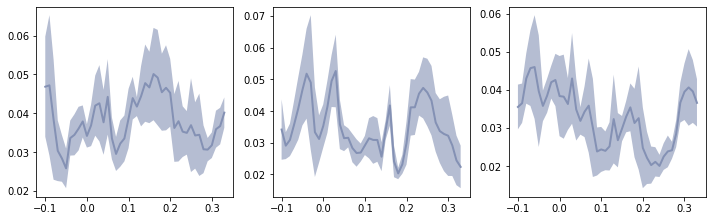

In [41]:
# Kullback-Leibler divergence but better because it's symmetric, we just need to norm the weights
from scipy.spatial import distance 

fig, axs = plt.subplots(figsize = (12,3.5), ncols = 3)
steps_movement = np.arange(0,45)
for i0, mat in enumerate(idxs):
    mat = coeffmat[:,:,mat]
    
    all_mean_disps = []
    for n_slice in range(6,15) :
        mean_disps = []
        list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slice) for x in steps_movement]
        for i1 in range(len(steps_movement)-1) :
            histo = np.mean(list_histo[i1], axis = -1)
            histo_t1 = np.mean(list_histo[i1+1], axis = -1)
            flat_histo_t0 = np.reshape(histo, [-1])
            flat_histo_t1 = np.reshape(histo_t1, [-1])
            mean_disps.append(distance.jensenshannon(norm_data(flat_histo_t0), norm_data(flat_histo_t1)))
        all_mean_disps.append(mean_disps)
    all_mean_disps = np.asarray(all_mean_disps)
    
    
    ax = axs[i0]
    meanplot = norm_data(np.mean(all_mean_disps, axis = 0))
    ax.plot(timesteps[:-17]+win_size,np.mean(all_mean_disps, axis = 0), c ='#8491B4FF', linewidth = 2)
    ax.fill_between(timesteps[:-17]+win_size,
                     np.mean(all_mean_disps, axis = 0) + np.std(all_mean_disps, axis = 0),
                    np.mean(all_mean_disps, axis = 0) - np.std(all_mean_disps, axis = 0),
                   facecolor ='#8491B499', edgecolor = None)
    
for i0, ax in enumerate(axs) :
    if i0 == 0 :
        ax.set_ylabel('Jensen-Shannon distance', fontsize = 18)
        ax.set_xlabel('PST (s)', fontsize = 18)
        ax.tick_params(labelsize = 14)
    else :
        ax.set_xticklabels([])
        ax.set_yticklabels([])
    ax.set_ylim(0.01, .06)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
    ax.hlines(.058, 0., .3, color = 'k', linewidth = 4)
    
fig.tight_layout()
#fig.savefig('./output/fig_4_indiv_jensenshannon.pdf', bbox_inches='tight', dpi=200, transparent=True)
plt.show()

# Spiderweb maps for the decoder

In [42]:
all_counts = np.zeros((8,12))
for ibt, bt in enumerate(B_thetas) :
    pref_oris = []
    for icluster, cluster_path in enumerate(cluster_list) :
        load_folder = '%s/%s' % (grouping_path, cluster_path)
        mean_FR = np.load(load_folder + '/0.000_plot_MC_TC_nonmerged_means.npy')
        pref_oris.append(np.argmax(mean_FR[ibt,:]))
    _, counts = np.unique(pref_oris, return_counts=True)
    all_counts[ibt,:] = counts

In [43]:
tsteps_markers = np.arange(0, tsteps[-1])
histo_arrays = np.zeros((len(tsteps_markers), len(thetas), len(B_thetas)))
for i0, _ in tqdm(enumerate(cluster_list), total = len(cluster_list)):
    mat = coeffmat[:, :, i0]

    list_histo = [make_histo(mat=mat, start_slice=x,
                             n_slices=n_slices) for x in tsteps_markers]
    for i1, histo in enumerate(list_histo):
        histo_arrays[i1, :,
                     :] += np.mean(histo, axis=-1) 

100%|██████████| 256/256 [00:02<00:00, 94.69it/s]


In [44]:
btt_prefs = []
for it, _ in enumerate(tsteps_markers):
    histo = histo_arrays[it,:,:]
    where_amax = np.where(histo == histo.max())

    if len(where_amax[0]) > 1 :
        for i2 in range(len(where_amax[0])) :
            btt_prefs.append(np.array([where_amax[0][i2], where_amax[1][i2]]))
    else :
        btt_prefs.append(np.concatenate(where_amax))

<ipython-input-45-c20d9f2c2e8b>:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


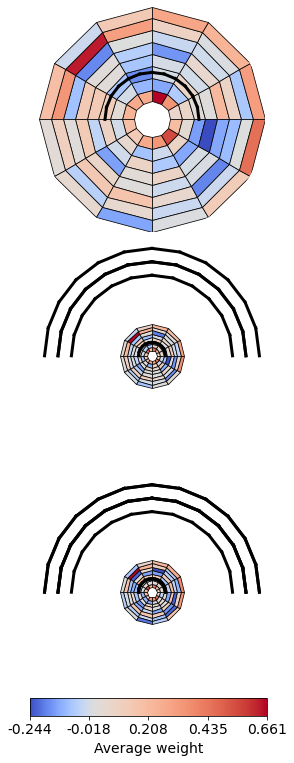

In [45]:
fig, axs = plt.subplots(figsize=(10, 10), ncols=1, nrows=3,
                        subplot_kw=dict(projection="polar", aspect='equal'))

rbins = np.linspace(0, np.pi, 13)
np.linspace(0.1, B_thetas[0], 9)
A, R = np.meshgrid(abins, rbins)
n_slices = 10  # 100 ms avg
times = ['t = 0 ms', 't = 150 ms', 't = 300 ms']

histo_arrays = np.zeros((3, 12, 8))
for i0, _ in enumerate(cluster_list):
    mat = coeffmat[:, :, i0]

    list_histo = [make_histo(mat=mat, start_slice=x,
                             n_slices=n_slices) for x in tsteps]
    for i1, histo in enumerate(list_histo):
        histo_arrays[i1, :,
                     :] += np.mean(histo, axis=-1) 

#histo_arrays = norm_data(histo_arrays)
for i1, tstep in enumerate(tsteps):
    ax = axs[i1]

    a = histo_arrays[i1, :, :]
    for ibt, bt in enumerate(B_thetas) :
        a[:,ibt] = a[:,ibt] / all_counts[ibt,:]
        
    pc = ax.pcolormesh(AZ*2, EL, a,
                       cmap="coolwarm", edgecolors='k', linewidth=.75,
                       antialiased=True, norm=mcols.TwoSlopeNorm(
                            vmin=np.min(a),
                            vmax=np.max(a),
                            vcenter=0))
    
    max_histo_bt = np.concatenate(np.where(a == np.max(a)))[::-1]
    pref_btt = np.unique(btt_prefs[19:tstep], axis = 0)[:,1]
    for ibt, pbtt in enumerate(pref_btt) :
        for i, rbin in enumerate(rbins[:-1]) :
            ax.plot([rbins[i], rbins[i+1]],
               [abins[pbtt], abins[pbtt]], c = 'k', linewidth = 3, zorder = 10)
            ax.plot([rbins[i], rbins[i+1]],
               [abins[pbtt+1], abins[pbtt+1]], c = 'k', linewidth = 3, zorder = 10)
            
    '''max_histo_bt = np.concatenate(np.where(a == np.max(a)))[::-1]
    pref_btt = np.unique(btt_prefs[:19], axis = 0)[:,1]
    for ibt, pbtt in enumerate(pref_btt) :
        for i, rbin in enumerate(rbins[:-1]) :
            ax.plot([rbins[i], rbins[i+1]],
               [abins[pbtt], abins[pbtt]], c = 'gray', linewidth = 3)
            ax.plot([rbins[i], rbins[i+1]],
               [abins[pbtt+1], abins[pbtt+1]], c = 'gray', linewidth = 3)'''

    if i1 == 2:
        ps = ax.get_position().get_points().flatten()
        cax = fig.add_axes([0.33, 0, .33, 0.025])

        cb_ticks = np.linspace(np.min(a),
                               np.max(a),
                               5)

        cb = fig.colorbar(
            pc, cax=cax, orientation='horizontal', ticks=cb_ticks)
        cb.ax.tick_params(labelsize=14)
        cb.ax.set_xticklabels(np.round(cb_ticks, 3))
        cax.set_xlabel('Average weight', labelpad=5, fontsize=14)


for i0, ax in enumerate(axs.flatten()):
    #ax.set_thetamin(0)
    #ax.set_thetamax(180)
    #ax.set_ylim(-.12, B_thetas[0]+.005)

    ax.spines['polar'].set_visible(False)
    ax.grid(False)

    if i0 == 2:
        ax.set_xticks([])
        ax.set_yticklabels([])
    else:
        ax.set_xticks([])
        ax.set_yticklabels([])

fig.tight_layout()
#fig.savefig('./output/fig_4_spiderwebs_decoder.pdf',
#            bbox_inches='tight', dpi=200, transparent=True)
plt.show()

In [46]:
# Kullback-Leibler divergence but better because it's symmetric, we just need to norm the weights
from scipy.spatial import distance 

steps_movement = np.arange(0,45)
global_mean_disp = np.zeros((len(cluster_list), 9, len(steps_movement)-1))
for i0, _ in tqdm(enumerate(cluster_list), total = len(cluster_list)):
    mat = coeffmat[:,:,i0]
    
    all_mean_disps = []
    for n_slice in range(6,15) :
        mean_disps = []
        list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slice) for x in steps_movement]
        for i1 in range(len(steps_movement)-1) :
            histo = np.mean(list_histo[i1], axis = -1)
            histo_t1 = np.mean(list_histo[i1+1], axis = -1)
            flat_histo_t0 = np.reshape(histo, [-1])
            flat_histo_t1 = np.reshape(histo_t1, [-1])
            mean_disps.append(distance.jensenshannon(norm_data(flat_histo_t0), norm_data(flat_histo_t1)))
        all_mean_disps.append(mean_disps)
    all_mean_disps = np.asarray(all_mean_disps)
    global_mean_disp[i0, :,:] = all_mean_disps

100%|██████████| 256/256 [00:33<00:00,  7.66it/s]


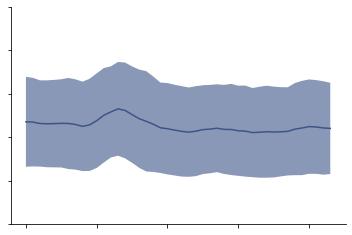

In [47]:
fig, ax = plt.subplots(figsize=(6, 4))
ax.plot(timesteps[:-17]+win_size,
        np.mean(np.mean(global_mean_disp, axis=0), axis=0),
        c='#3C5488FF')
ax.fill_between(timesteps[:-17]+win_size,
                np.mean(np.mean(global_mean_disp, axis=0), axis=0) +
                np.mean(np.std(global_mean_disp, axis=0), axis=0),
                np.mean(np.mean(global_mean_disp, axis=0), axis=0) -
                np.mean(np.std(global_mean_disp, axis=0), axis=0),
                facecolor = '#3C548899', edgecolor = None)

ax.set_xticklabels([])
ax.set_yticklabels([])

ax.set_ylim(0.01, .06)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

In [48]:
n_slices

10

In [49]:
n_slices = 5
steps_ratio = np.arange(0, 61 - n_slices)
#steps_ratio = steps_movement
t_histo_arrays = np.zeros((len(steps_ratio), 12, 8))
for i0, _ in tqdm(enumerate(cluster_list), total = len(cluster_list)):
    mat = coeffmat[:,:,i0]
    
    list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slices) for x in steps_ratio]
    for i1, histo in enumerate(list_histo) :
        t_histo_arrays[i1, :, :] += np.mean(histo, axis = -1)

100%|██████████| 256/256 [00:01<00:00, 129.61it/s]


In [50]:
inner = np.mean(np.mean(t_histo_arrays[:,:,:-4], axis = -1), axis = -1)
outer = np.mean(np.mean(t_histo_arrays[:,:,4:], axis = -1), axis = -1)

In [51]:
import scipy.stats
def mean_confidence_interval(data, confidence=0.99):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a, axis = -1), scipy.stats.sem(a, axis = -1)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h

In [52]:
np.arange(0, 61 - n_slices).shape

(56,)

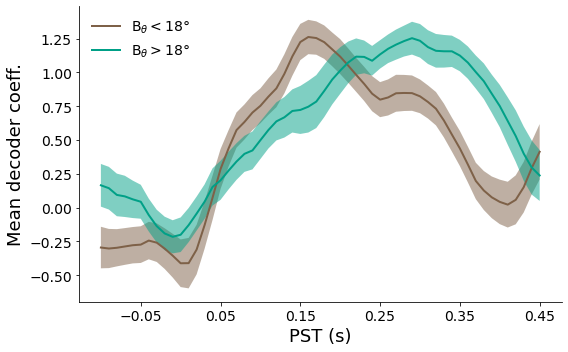

In [53]:
fig, ax = plt.subplots(figsize = (8,5))

cols = [r'#00A087FF', r'#7E6148FF']

ax.plot(timesteps[steps_ratio]+win_size, 
       outer, linewidth = 2, color = cols[1],
       label = r'B$_\theta  < 18°$')
a = np.std(np.mean(t_histo_arrays[:,:,4:], axis = -1), axis = -1) / np.sqrt(len(outer))
ax.fill_between(timesteps[steps_ratio]+win_size,
               outer - a, outer + a,  facecolor = cols[1],
                edgecolor = None,alpha = .5)

ax.plot(timesteps[steps_ratio]+win_size, 
       inner, linewidth = 2, color = cols[0],
       label = r'B$_\theta > 18°$', zorder = 5)
a = np.std(np.mean(t_histo_arrays[:,:,:-4], axis = -1), axis = -1) / np.sqrt(len(outer))
ax.fill_between(timesteps[steps_ratio]+win_size,
               inner - a, inner + a,  facecolor = cols[0],
                edgecolor = None,alpha = .5)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

xs = timesteps[steps_ratio]+win_size
ax.set_xticks([ -.05, 0.05, 0.15, 0.25, 0.35, .45])
ax.tick_params(axis='both', which='major', labelsize=14)
ax.set_xlabel('PST (s)', fontsize = 18)
ax.set_ylabel('Mean decoder coeff.', fontsize = 18)

ax.legend( frameon = False, fontsize = 14, markerscale = .3)
fig.tight_layout()
fig.savefig('./output/fig_4_popweights.pdf',
            bbox_inches='tight', dpi=200, transparent=True)
plt.show()

In [54]:
xs.max()

0.4500000000000005

# Spiderweb maps using confusion matrices
In this case, a row corresponds to the training and a column to the testing. So you can test from one btheta to another, see how neuron classes communicate 

In [55]:
try:
    all_cms = np.load('./data/sup_7_fans_BTT_cms.npy', allow_pickle = True)

except:
    all_cms = get_cm_kfold_btt(cm_timesteps=timesteps[tsteps], shuffled = False)
    np.save('./data/sup_7_fans_BTT_cms.npy', all_cms)


Loading data: 100%|██████████| 3/3 [00:07<00:00,  2.39s/it]


In [56]:
bt_idxs = [0,4,7]

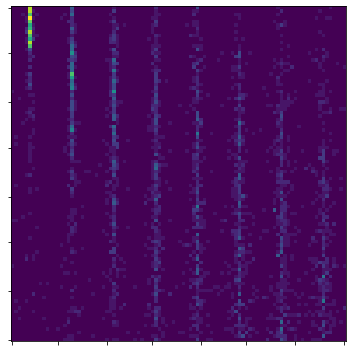

In [57]:
# Step one, rolling over the angles
a = np.mean(all_cms[-1])
for k in range(N_thetas*N_B_thetas) :
    a[k,:] = np.roll(a[k,:], -(k%N_thetas)+N_thetas//2-1)
    
fig, ax = plt.subplots(figsize = (5,5))
i = ax.imshow(a, interpolation = 'None')

xticks = np.linspace(0, 95, 8, dtype = np.int16)
ax.set_xticks(xticks)
ax.set_yticks(xticks)
ax.set_xticklabels([])
ax.set_yticklabels([])
fig.tight_layout()
fig.savefig('./output/sup_7_nonpolar.pdf',
            bbox_inches='tight', dpi=200, transparent=True)
plt.show()


# Step two, taking the average across multiple bthetas
# no need to plot this one i think
a2 = a.reshape((12,8,96)).mean(axis = 0)

list_histo = np.zeros((len(bt_idxs), 12, 8))
for i, ibt in enumerate(bt_idxs) :
    list_histo[i,:,:] =  np.swapaxes(a2[ibt].reshape(8,12), 0, -1)

<ipython-input-58-67a96a9faff7>:56: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


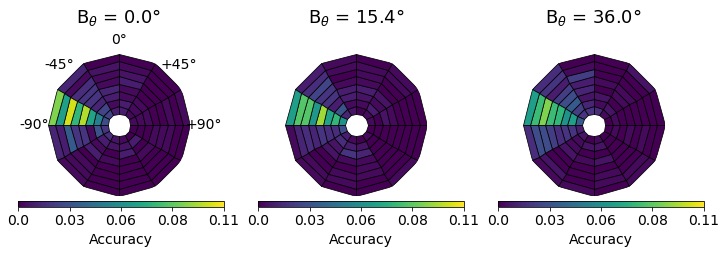

In [58]:
fig, axs = plt.subplots(figsize=(10, 3), ncols=3, nrows=1,
                        subplot_kw=dict(projection="polar", aspect='equal'))

rbins = np.linspace(0, np.pi, 12)
np.linspace(0.1, B_thetas[0], 9)
A, R = np.meshgrid(abins, rbins)
n_slices = 10  # 100 ms avg
times = [r'B$_\theta$ = 0.0°', r'B$_\theta$ = 15.4°', r'B$_\theta$ = 36.0°']

#histo_arrays = norm_data(histo_arrays)
for i1 in range(list_histo.shape[0]) :
    ax = axs[i1]

    a = list_histo[i1,:,::-1]
    pc = ax.pcolormesh(AZ*2, EL, a,
                       cmap="viridis", edgecolors='k', linewidth=.75,
                       antialiased=True,
                       vmin = 0.0,
                       vmax = 0.11)
    

    ps = ax.get_position().get_points().flatten()
    cax = fig.add_axes([(1/3*i1)+.05, 0, (1/3.5), 0.025])

    cb_ticks = np.linspace(0.0,
                           0.11,
                           5)

    cb = fig.colorbar(
        pc, cax=cax, orientation='horizontal', ticks=cb_ticks)
    cb.ax.tick_params(labelsize=14)
    cb.ax.set_xticklabels(np.round(cb_ticks, 2))
    cax.set_xlabel('Accuracy', labelpad=5, fontsize=14)
    
    ax.text(x = np.pi/2, y = .95, s = times[i1], fontsize = 18,
                   va = 'center', ha = 'center', rotation = 0)


for i0, ax in enumerate(axs.flatten()):
    #ax.set_thetamin(0)
    #ax.set_thetamax(180)
    #ax.set_ylim(-.12, B_thetas[0]+.005)

    ax.spines['polar'].set_visible(False)
    ax.grid(False)

    if i0 == 0:
        ax.set_xticks(np.radians([0, 45, 90, 135, 180]))
        ax.set_xticklabels(['+90°', '+45°', '0°', '-45°', '-90°'])
        ax.tick_params(labelsize=14)
        ax.set_yticklabels([])
    else:
        ax.set_xticks([])
        ax.set_yticklabels([])

fig.tight_layout()
fig.savefig('./output/sup_7_spiderweb_accuracy.pdf',
            bbox_inches='tight', dpi=200, transparent=True)
plt.show()

# Showing all neurons

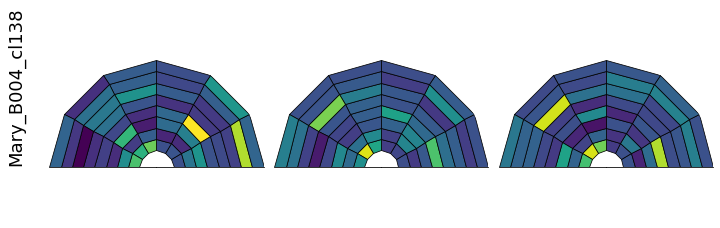

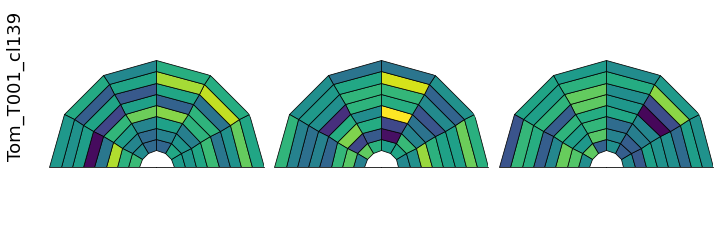

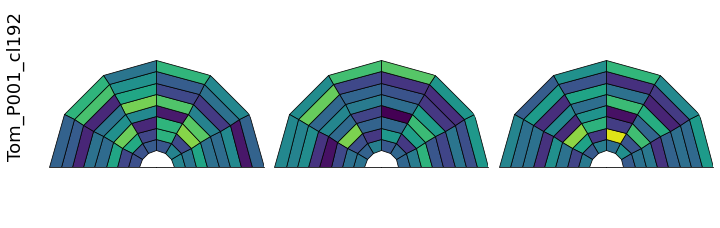

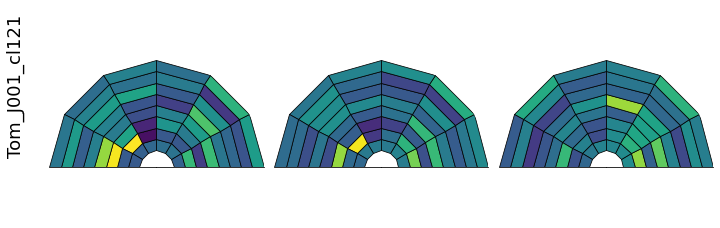

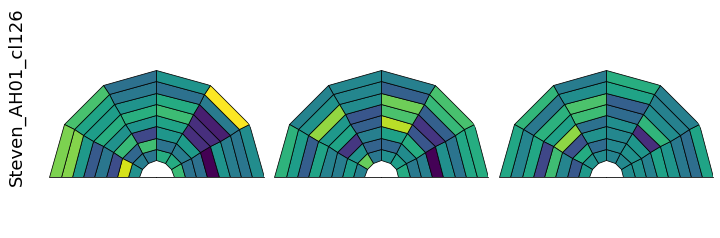

...

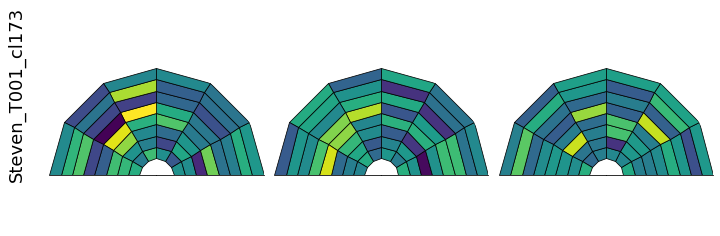

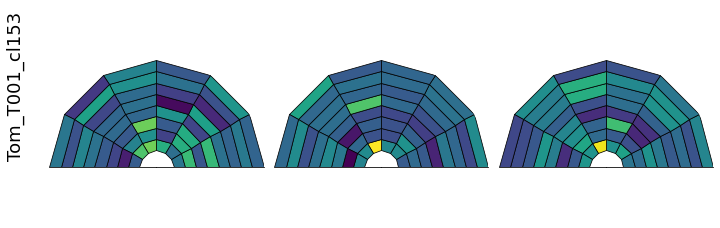

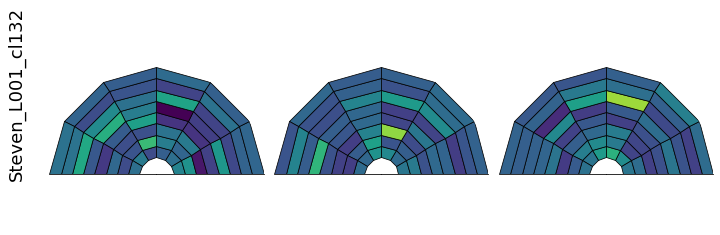

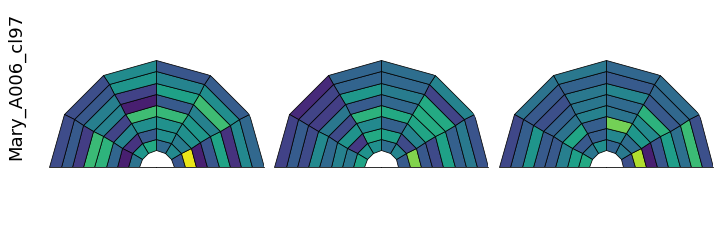

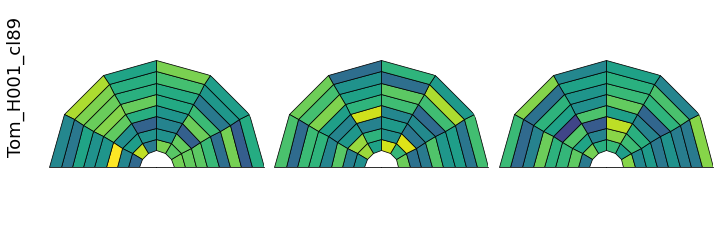

In [59]:
if True:
    for neur_idx in range(coeffmat.shape[-1]) :
        fig, axs = plt.subplots(figsize = (10,10), ncols = 3, nrows = 1,
                               subplot_kw=dict(projection="polar", aspect = 'equal'))

        rbins = np.linspace(0, np.pi, 13)
        abins = np.linspace(0.1,B_thetas[0], 9)
        A, R = np.meshgrid(abins, rbins)
        n_slices = 10 #100 ms avg
        vmin, vmax = 0, 1
        times = ['t = -150 ms', 't = 0 ms', 't = 300 ms']

        mat = coeffmat[:,:,neur_idx]

        list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slices) for x in tsteps]
        list_histo = np.asarray(list_histo)
        for i1, tstep in enumerate(tsteps) :
            histo = list_histo[i1]

            ax = axs[i1]
            pc = ax.pcolormesh(AZ*2, EL, np.mean(histo, axis = -1),
                               cmap="viridis", edgecolors = 'k', linewidth = .75,
                                antialiased = True,
                              vmin = np.min(np.min(np.mean(list_histo, axis = -1))),
                               vmax = np.min(np.max(np.mean(list_histo, axis = -1))))

        axs[0].text(x = 5*np.pi/6, y = .95, s = cluster_list[neur_idx], fontsize = 18,
               va = 'center', ha = 'center', rotation = 90)


        for i0, ax in enumerate(axs.flatten()) :
            ax.set_thetamin(0)
            ax.set_thetamax(180)
            #ax.set_ylim(-.12, B_thetas[0]+.005)

            ax.spines['polar'].set_visible(False)

            if i0 == 6 :
                ax.set_xticks(np.radians([0, 45, 90, 135, 180]))
                ax.tick_params(labelsize = 14)
            else :
                ax.set_xticks([])
                ax.set_yticklabels([])

        fig.tight_layout()
        #fig.savefig('./output/fig_4_spiderwebs.pdf', bbox_inches='tight', dpi=200, transparent=True)
        plt.show()
        
invar_lst = ['Tom_T001_cl139', 'Tom_M001_cl126', 'Tom_W001_cl81']
var_low_high_lst = ['Steven_L001_cl26']
var_high_low_lsst = ['Tom_I001_cl114', 'Steven_R002_cl218']
get_suppr_lst = ['Steven_L002_cl112', 'Mary_C006c_cl61', 'Tom_C001_cl76',
                'Steven_AK001_cl143']


In [60]:
if True:
    nice_list = ['Steven_K001_cl74', 'Steven_AC01_cl134', 'Steven_AC01_cl139', 'Tom_V001_cl19', 'Tom_AA01_cl132', 'Tom_P001_cl136', 'Tom_S001_cl84',
                 'Tom_R001_cl167', 'Tom_M002_cl178', 'Tom_V001_cl19', 'Mary_B004_cl48', 'Mary_B004_cl47',
                 'Steven_I001_cl171', 'Tom_M001_cl100', 'Steven_G001_cl121']
    nice_list = ['Mary_A006_cl18' , 'Tom_I002_cl185' , 'Tom_V001_cl103']

    for neur in nice_list :
        neur_idx = cluster_list.index(neur)
        fig, axs = plt.subplots(figsize = (10,10), ncols = 3, nrows = 1,
                               subplot_kw=dict(projection="polar", aspect = 'equal'))

        rbins = np.linspace(0, np.pi, 12)
        abins = np.linspace(0.1,B_thetas[0], 9)
        A, R = np.meshgrid(abins, rbins)
        n_slices = 10 #100 ms avg
        times = ['t = -150 ms', 't = 0 ms', 't = 300 ms']

        mat = coeffmat[:,:,neur_idx]

        list_histo = [make_histo(mat = mat, start_slice = x, n_slices = n_slices) for x in tsteps]
        list_histo = np.asarray(list_histo)
        for i1, tstep in enumerate(tsteps) :
            histo = list_histo[i1]

            ax = axs[i1]
            pc = ax.pcolormesh(AZ*2, EL, np.mean(histo, axis = -1),
                               cmap="viridis", edgecolors = 'k', linewidth = .75,
                                antialiased = True,
                              vmin = np.min(np.min(np.mean(list_histo, axis = -1))),
                               vmax = np.min(np.max(np.mean(list_histo, axis = -1))))

            #fig.colorbar(pc, ax = ax)
        axs[0].text(x = 5*np.pi/6, y = .95, s = '%s;%s' % (cluster_list[neur_idx], neur_idx),
                    fontsize = 18,
               va = 'center', ha = 'center', rotation = 90)

            
        for i0, ax in enumerate(axs.flatten()) :
            ax.set_thetamin(0)
            ax.set_thetamax(180)

            ax.spines['polar'].set_visible(False)

            if i0 == 6 :
                ax.set_xticks(np.radians([0, 45, 90, 135, 180]))
                ax.tick_params(labelsize = 14)
            else :
                ax.set_xticks([])
                ax.set_yticklabels([])
                
        fig.tight_layout()
        #fig.savefig('./output/fig_4_spiderwebs.pdf', bbox_inches='tight', dpi=200, transparent=True)
        plt.show()   

AttributeError: 'numpy.ndarray' object has no attribute 'index'

## In the population, how much change is there between each timestep : different bthetas, different thetas ? we can count bins that are X% above mean coeff as peaks

### it's not enough to count the fraction of X% above in each btheta slice, because if everybody is moving in opposite direction, we can't see anything. So we need to track each individual pixel

In [61]:
if True:

    tsteps = np.arange(20, 50) # timesteps at which the coeffs will be checked
    n_slices = 10 # 100 ms average coeffs

    all_dts, all_dbts = [],[]
    for neur_idx in tqdm(range(coeffmat.shape[-1])) :

        mat = coeffmat[:,:,neur_idx]

        # Make histograms
        rbins = np.linspace(0, np.pi, 12)
        abins = np.linspace(B_thetas[0],0, 8)
        A, R = np.meshgrid(abins, rbins)

        histos = [make_histo(mat = mat, start_slice = tstep, n_slices = n_slices) for tstep in tsteps]
        histos = np.asarray(histos)
        histos = np.mean(histos, axis = -1)

        # Threshold is mean+std
        thresh = np.mean(histos) + np.std(histos)

        avg_dts, avg_dbts = [], []
        # At each timestep, we track the movement of each signif pixel
        for t in np.arange(0, len(tsteps)-1) :
            h1, h2 = np.where(histos[t] > thresh), np.where(histos[t+1]> thresh)

            # For each signif pixel, we find the nearest neighbour at t+1 using euclidean distance
            dts, dbts = [], []
            for i0, _ in enumerate(h1[0]) :
                # Sometimes not same number of signif at t and t+1, so we stop
                # once t+1 is fully matched with t
                if len(h2[0]) > 0 :
                    coo1 = (h1[0][i0], h1[1][i0])
                    dists = [np.sqrt( (coo1[0] - h2[0][i2]) ** 2 + (coo1[1] - h2[1][i2]) ** 2) for i2 in range(len(h2[0]))]
                    coo2 = (h2[0][np.argmin(dists)], h2[1][np.argmin(dists)])

                    # we delete coo2 so as not to repick it
                    h2 = (np.delete(h2[0],np.argmin(dists)), np.delete(h2[1], np.argmin(dists)))

                    # Then delta theta is diff in x, delta bt diff in y
                    delta_theta = np.sqrt((coo2[0] - coo1[0])**2)
                    delta_bt = np.sqrt((coo2[1] - coo1[1])**2)

                    dts.append(delta_theta * (thetas[1] - thetas[0]))
                    dbts.append(delta_bt * (B_thetas[0] - B_thetas[1]))

            avg_dts.append(np.mean(dts))
            avg_dbts.append(np.mean(dbts))

        all_dts.append(avg_dts)
        all_dbts.append(avg_dbts)

    all_dts = np.asarray(all_dts)
    all_dbts = np.asarray(all_dbts)

100%|██████████| 256/256 [00:07<00:00, 33.42it/s]


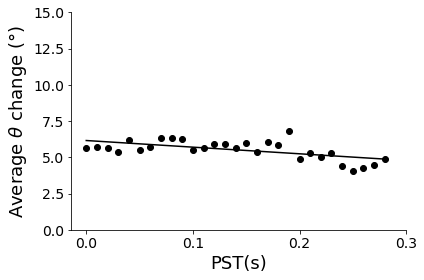

In [62]:
if True:
    fig, ax = plt.subplots(figsize = (6,4))

    xs = timesteps[tsteps][:-1]
    ys = np.nanmean(all_dts, axis = 0)*180/np.pi

    ax.scatter(xs, ys, c = 'k')

    slope, intercept, rvalue, pvalue, stderr = stats.linregress(xs, ys)
    ax.plot(xs, slope * xs + intercept, c = 'k')

    ax.set_ylim(0, (thetas[1]-thetas[0])*180/np.pi)

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax.set_xticks([0, 0.1, 0.2, 0.3])

    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_ylabel(r'Average $\theta$ change (°)', fontsize = 18)
    ax.set_xlabel('PST(s)', fontsize=18)

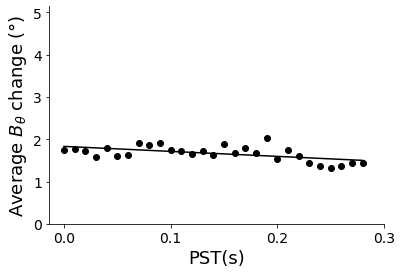

In [63]:
if True:
    fig, ax = plt.subplots(figsize = (6,4))
    xs
    xs = timesteps[tsteps][:-1]
    ys = np.nanmean(all_dbts, axis = 0)*180/np.pi

    ax.scatter(xs, ys, c = 'k')

    slope, intercept, rvalue, pvalue, stderr = stats.linregress(xs, ys)
    ax.plot(xs, slope * xs + intercept, c = 'k')

    ax.set_ylim(0, (B_thetas[0]-B_thetas[1])*180/np.pi)

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax.set_xticks([0, 0.1, 0.2, 0.3])

    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_ylabel(r'Average $B_\theta$ change (°)', fontsize = 18)
    ax.set_xlabel('PST(s)', fontsize=18)